<a href="https://colab.research.google.com/github/Kou2004/MemoTag-assignment/blob/main/Audio_Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Loading of Files

In [ ]:
import zipfile
import os

zip_path = '/content/Audio.zip'
extract_path = 'content/audio_1/'

with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_path)

print(f"Extracted all files to: {extract_path}")


Extracted all files to: content/audio_1/


In [ ]:
pip install pydub

# Converted to .wav files

In [ ]:
import os
from pydub import AudioSegment

audio_folder = "/content/content/audio_1/Audio/"  # Path to your audio folder
output_folder = "/content/content/audio_1/wav/"  # Path to store converted WAV files

# Create the output folder if it doesn't exist
os.makedirs(output_folder, exist_ok=True)

# Iterate through all files in the audio folder
for filename in os.listdir(audio_folder):
    if filename.endswith(".mp3"):  # Check if the file is an MP3
        # Construct the full file paths
        mp3_path = os.path.join(audio_folder, filename)
        wav_path = os.path.join(output_folder, filename[:-4] + ".wav")  # Replace .mp3 with .wav

        # Load the MP3 file and convert to WAV
        sound = AudioSegment.from_mp3(mp3_path)
        sound.export(wav_path, format="wav")

        print(f"Converted: {filename} to {filename[:-4] + '.wav'}")

print("Conversion complete!")


Converted: WhatsApp Audio 2025-04-15 at 10.13.47_55a9628c.mp3 to WhatsApp Audio 2025-04-15 at 10.13.47_55a9628c.wav
Converted: WhatsApp Audio 2025-04-15 at 10.13.47_4c85bafd.mp3 to WhatsApp Audio 2025-04-15 at 10.13.47_4c85bafd.wav
Converted: WhatsApp Audio 2025-04-15 at 10.13.47_eab72436.mp3 to WhatsApp Audio 2025-04-15 at 10.13.47_eab72436.wav
Converted: WhatsApp Audio 2025-04-15 at 10.13.46_1cd98663.mp3 to WhatsApp Audio 2025-04-15 at 10.13.46_1cd98663.wav
Converted: WhatsApp Audio 2025-04-15 at 10.13.47_ef55280e.mp3 to WhatsApp Audio 2025-04-15 at 10.13.47_ef55280e.wav
Conversion complete!


# Playing of the audio files

In [ ]:
from IPython.display import Audio

for file in os.listdir(output_folder):
    if file.endswith(".wav"):
        audio_file = os.path.join(output_folder, file)
        display(Audio(audio_file))

In [ ]:
pip install pysptk

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 461.9/461.9 kB 15.9 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for pysptk: filename=pysptk-1.0.1-cp311-cp311-linux_x86_64.whl size=1293745 sha256=519d2ab2f2047f625d53de55f9f7f192e5bfee482343f9288452c4f3ab89d4b1
  Stored in directory: /root/.cache/pip/wheels/f7/8e/e6/be2295ab3cba2d52e826922cd3ea8bda4a18210c03584dc759
Successfully built pysptk


# Waveform and the MEI spectrogram of the Audio files

In [ ]:
import librosa
import pysptk
import numpy as np
import librosa.display
import matplotlib.pyplot as plt

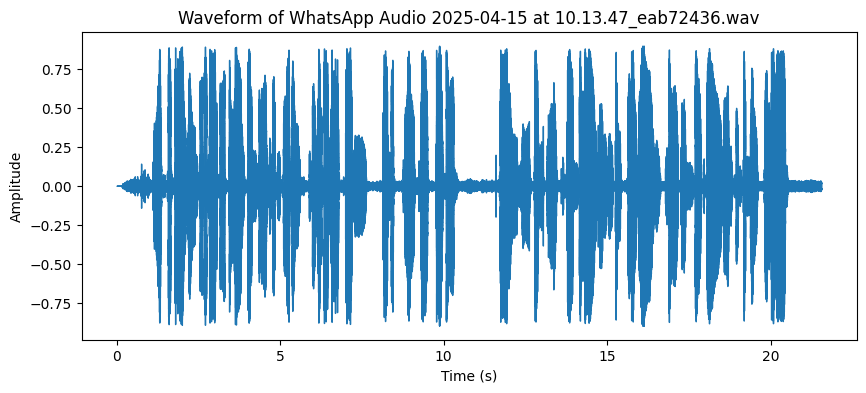

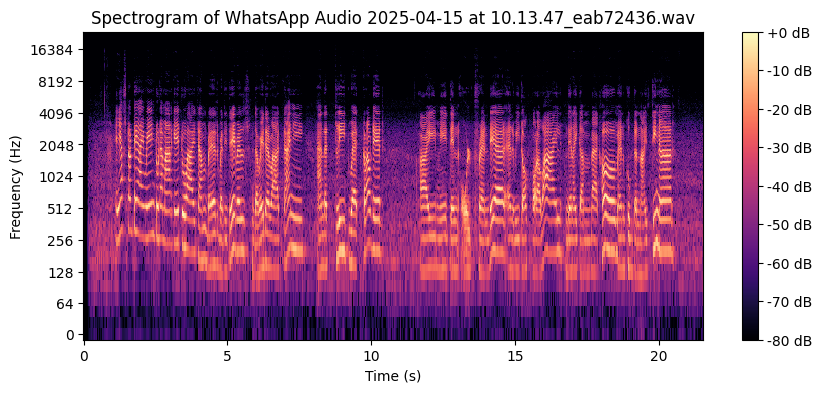

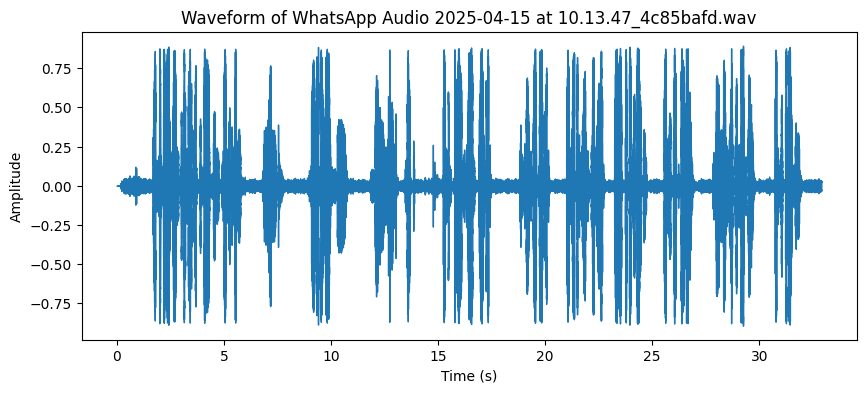

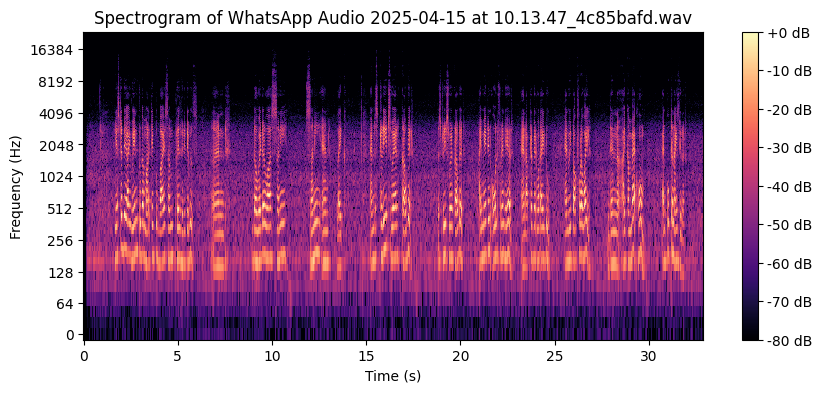

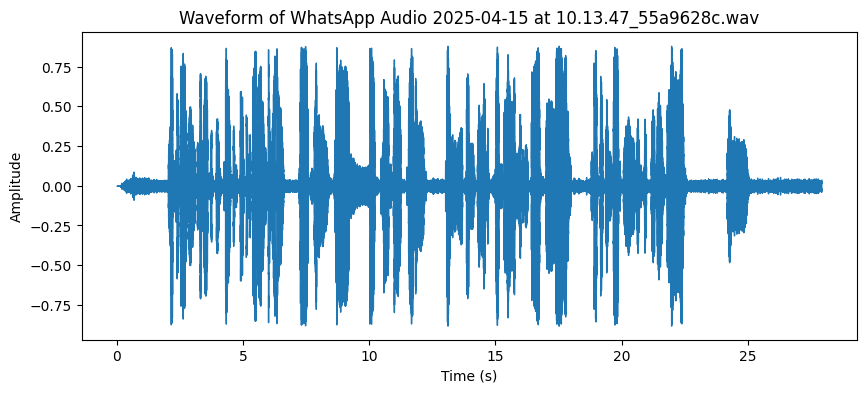

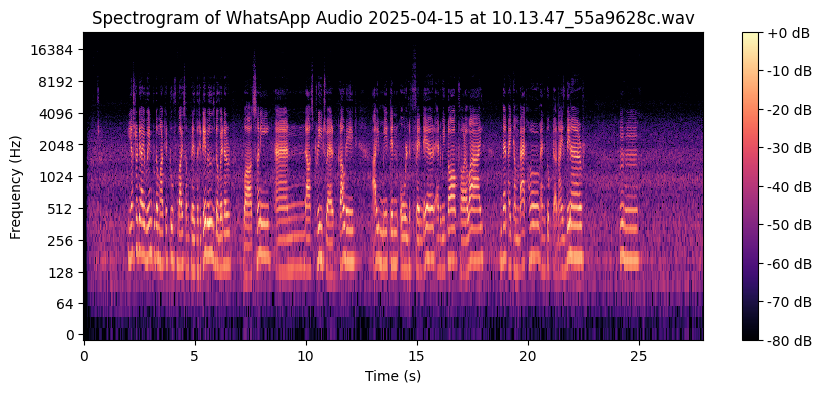

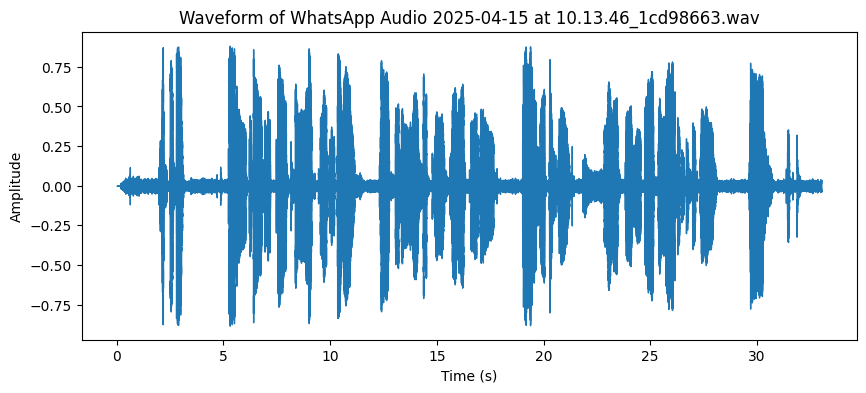

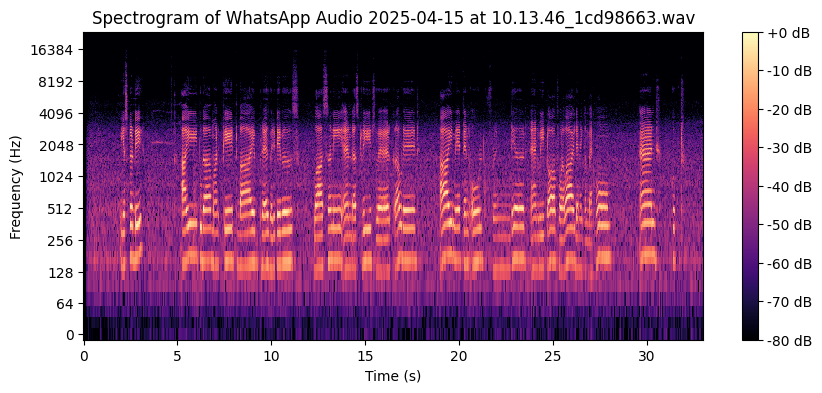

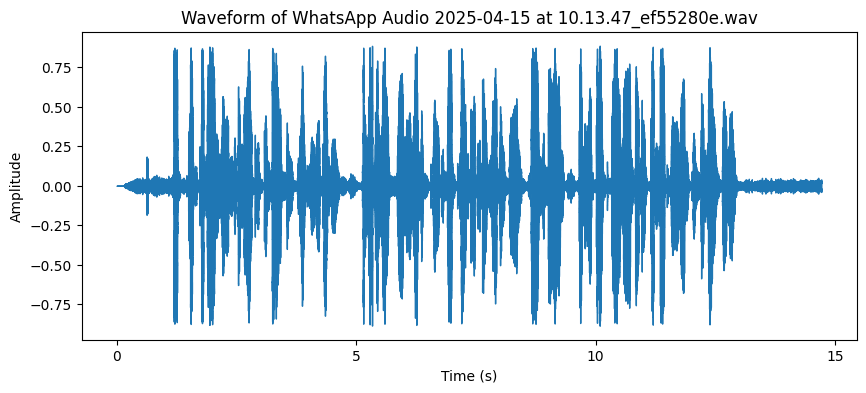

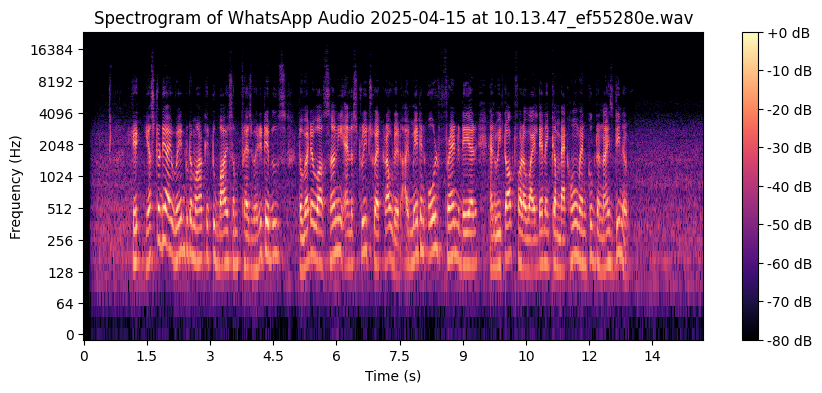

In [ ]:
# Load audio file
for file in os.listdir(output_folder):
    if file.endswith(".wav"):
        audio_file = os.path.join(output_folder, file)
        y, sr = librosa.load(audio_file, sr=None)
        plt.figure(figsize=(10, 4))
        librosa.display.waveshow(y, sr=sr)
        plt.title(f"Waveform of {file}")
        plt.xlabel("Time (s)")
        plt.ylabel("Amplitude")
        plt.show()

        plt.figure(figsize=(10, 4))
        D=librosa.amplitude_to_db(np.abs(librosa.stft(y)), ref=np.max)
        librosa.display.specshow(D, sr=sr, x_axis='time', y_axis='log')
        plt.colorbar(format='%+2.0f dB')
        plt.title(f"Spectrogram of {file}")
        plt.xlabel("Time (s)")
        plt.ylabel("Frequency (Hz)")
        plt.show()


There is no background noise in my audio files,so I dont need to apply any noise reduction techniques.

# Pause Detection
For detection of silence part we cam use different methods like energy trimming, amplitude trimming etc. Here I used Pydub library of python, which uses dBFS (decibels relative to full scale).
In this case, I manually set min_silence_len to 0.7 seconds and silence_db_offset to 16 dB. After that ,I extract features like :

1. Total audio duration
2. silence ratio= (total_silence duration/total duration)
3. number of silent segments
4. average silent duration
5. maximum silent duration

In [ ]:
#!pip install hmmlearn

In [ ]:
from pydub import AudioSegment
from pydub.silence import detect_silence


def plot_silence_waveform(file_path, min_silence_len=800, silence_db_offset=16):
    # Load audio
    audio = AudioSegment.from_file(file_path)
    duration=len(audio)/1000

    # Detect silence
    silence_thresh = audio.dBFS - silence_db_offset
    silences = detect_silence(audio, min_silence_len, silence_thresh)
    silences = [(start/1000, end/1000) for start, end in silences]  # to seconds
    silence_durations = [end - start for start, end in silences]
    total_silence = sum(silence_durations)

    features = {
        "total_audio_duration": duration,
        "silence_ratio": total_silence / duration if duration > 0 else 0,
        "num_silence_segments": len(silences),
        "avg_silence_duration": np.mean(silence_durations) if silence_durations else 0,
        "max_silence_duration": max(silence_durations) if silence_durations else 0,
    }

    # Convert to numpy array
    samples = np.array(audio.get_array_of_samples())
    if audio.channels == 2:
        samples = samples.reshape((-1, 2))
        samples = samples.mean(axis=1)

    # Time axis
    duration = len(audio) / 1000
    time = np.linspace(0, duration, num=len(samples))

    # Plotting
    plt.figure(figsize=(15, 5))
    plt.plot(time, samples, color='blue')

    for i, (start, end) in enumerate(silences):
        plt.axvspan(start, end, color='yellow', alpha=0.4, label='Silence' if i == 0 else "")

    file_name = file_path.split("/")[-1]
    plt.title(f"Waveform of {file_name}")
    plt.xlabel("Time (s)")
    plt.ylabel("Amplitude")
    plt.legend()
    plt.tight_layout()
    plt.show()
    return features



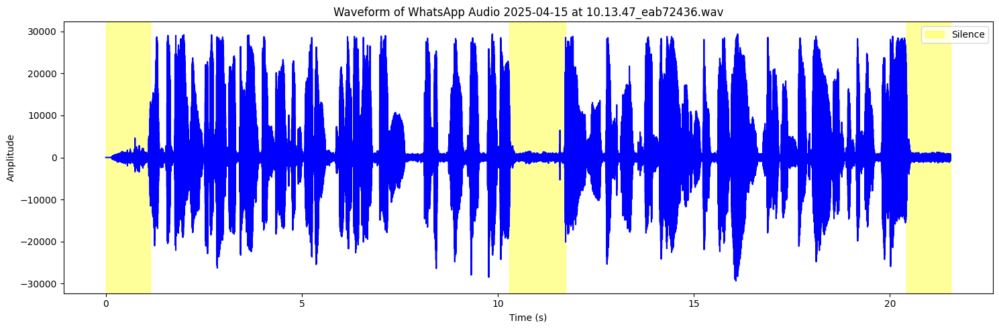

/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


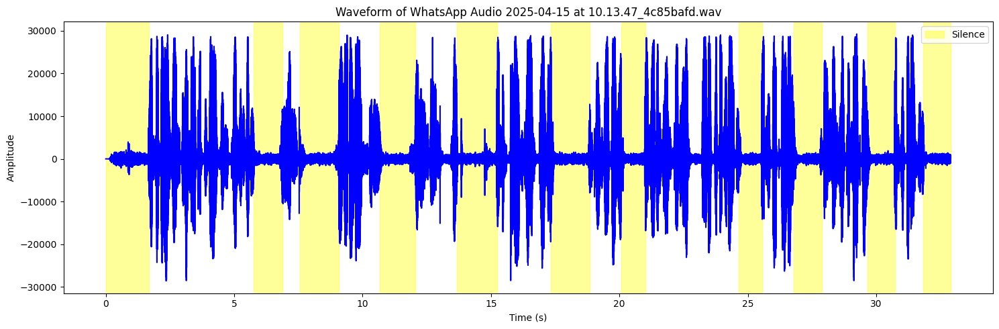

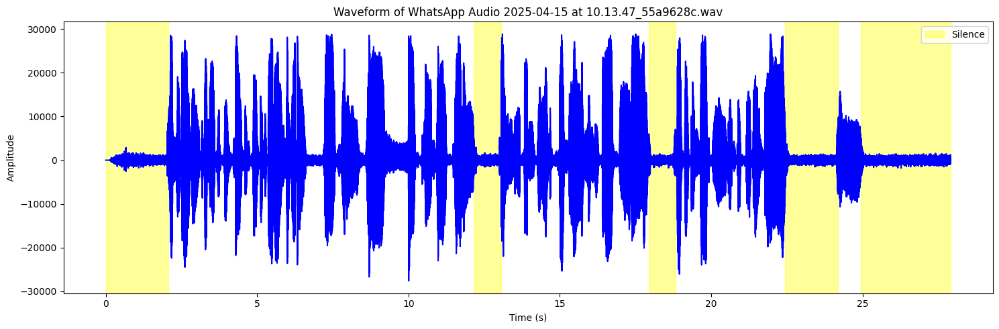

<ipython-input-45-d4e82a213cfe>:47: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout()


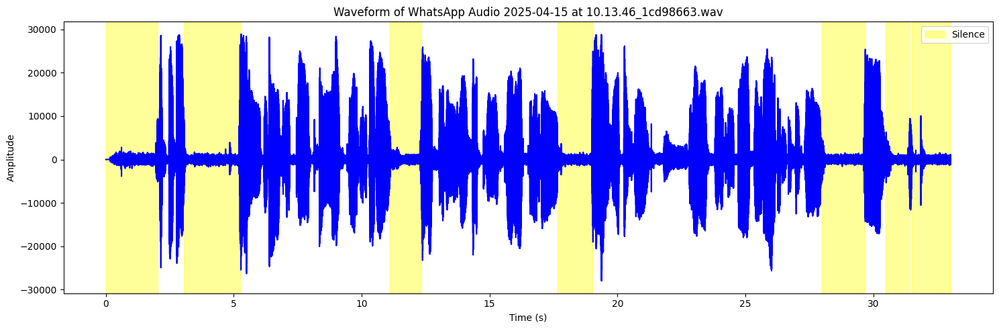

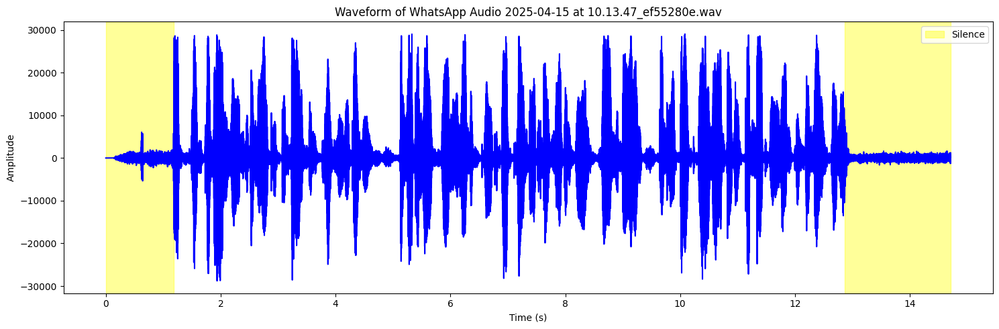

In [ ]:
features_pause=[]
for file in os.listdir(output_folder):
    if file.endswith(".wav"):
        audio_file = os.path.join(output_folder, file)
        f=plot_silence_waveform(audio_file)
        features_pause.append((file,f))

Yellow regions are the silent regions.

In [ ]:
features_pause

[('WhatsApp Audio 2025-04-15 at 10.13.47_eab72436.wav',
  {'total_audio_duration': 21.552,
   'silence_ratio': 0.17102821083890132,
   'num_silence_segments': 3,
   'avg_silence_duration': np.float64(1.228666666666667),
   'max_silence_duration': 1.4290000000000003}),
 ('WhatsApp Audio 2025-04-15 at 10.13.47_4c85bafd.wav',
  {'total_audio_duration': 32.904,
   'silence_ratio': 0.42089107707269635,
   'num_silence_segments': 11,
   'avg_silence_duration': np.float64(1.2590000000000001),
   'max_silence_duration': 1.679}),
 ('WhatsApp Audio 2025-04-15 at 10.13.47_55a9628c.wav',
  {'total_audio_duration': 27.912,
   'silence_ratio': 0.3063915161937517,
   'num_silence_segments': 5,
   'avg_silence_duration': np.float64(1.7103999999999995),
   'max_silence_duration': 2.9689999999999976}),
 ('WhatsApp Audio 2025-04-15 at 10.13.46_1cd98663.wav',
  {'total_audio_duration': 33.024,
   'silence_ratio': 0.3326974321705428,
   'num_silence_segments': 7,
   'avg_silence_duration': np.float64(1.569

We have got the silence ratio, but its define the overall silence feature of the audio file. I am defining a new feature , which is the r2 score of the current silent segment to the previous non-silent segment. High r2 score means , that telling long sentence, speaker gets tired, lower means there is something abnormal. if there are lesser silent segments < 2, then we can say that speaker is very frequent, so I keep the r2 score here as 0.95

In [ ]:
from pydub import AudioSegment
from pydub.silence import detect_nonsilent
import numpy as np
import scipy.stats
def get_silence_dependency_r2(audio_path, min_silence_len=800, silence_db_offset=16):
    # Load audio
    audio = AudioSegment.from_wav(audio_path)

    # Silence threshold
    silence_thresh = audio.dBFS - silence_db_offset

    # Detect non-silent parts
    nonsilent_ranges = detect_nonsilent(audio, min_silence_len=min_silence_len, silence_thresh=silence_thresh)
    # this means he doesnt stop at anywhere so good r2_score
    if len(nonsilent_ranges) < 2:
        return 0.95

    # Build time pairs
    time_pairs = []
    prev_end = 0
    for start, end in nonsilent_ranges:
        non_silent_duration = end - start
        silent_duration = start - prev_end
        time_pairs.append((non_silent_duration, silent_duration))
        prev_end = end

    # Exclude first (to avoid zero-start bias)
    speech_durations = [x[0] for x in time_pairs[1:]]
    silence_durations = [x[1] for x in time_pairs[1:]]
    # this means he doesnt stop at anywhere so good r2_score
    if len(speech_durations) < 2:
        return 0.95

    # Linear regression
    slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(speech_durations, silence_durations)
    r_squared = r_value ** 2

    return r_squared



In [ ]:
r2_pause=[]
for file in os.listdir(output_folder):
    if file.endswith(".wav"):
        audio_file = os.path.join(output_folder, file)
        r2_value = get_silence_dependency_r2(audio_file)
        r2_pause.append((file, r2_value))

In [ ]:
import pandas as pd


df_features = pd.DataFrame([{"File Name": name, **features} for name, features in features_pause])
df_r2 = pd.DataFrame(r2_pause, columns=["File Name", "R2_Pause_Dependency"])

# Step 2: Merge on 'File Name'
df_merged = pd.merge(df_features, df_r2, on="File Name")

# Step 3: Show the final DataFrame
df_merged

,File Name,total_audio_duration,silence_ratio,num_silence_segments,avg_silence_duration,max_silence_duration,R2_Pause_Dependency
0,WhatsApp Audio 2025-04-15 at 10.13.47_eab72436...,21.552,0.171028,3,1.228667,1.429,0.950000
1,WhatsApp Audio 2025-04-15 at 10.13.47_4c85bafd...,32.904,0.420891,11,1.259000,1.679,0.017914
2,WhatsApp Audio 2025-04-15 at 10.13.47_55a9628c...,27.912,0.306392,5,1.710400,2.969,0.897549
3,WhatsApp Audio 2025-04-15 at 10.13.46_1cd98663...,33.024,0.332697,7,1.569571,2.191,0.068561
4,WhatsApp Audio 2025-04-15 at 10.13.47_ef55280e...,14.712,0.205886,2,1.514500,1.845,0.950000


# Pitch Variability

We are going to use the librosa piptrack library to get the pitch values, we will only find the pitch for the non-silent regions, as silent regions only consider background noise.

In [ ]:
from pydub import silence
import soundfile as sf
import io

def calculate_pitch_std(audio_file_path, min_silence_len=800, silence_thresh_db=-14, keep_silence=100):

    # Load audio using pydub
    sound = AudioSegment.from_file(audio_file_path, format="wav")

    # Detect non-silent chunks (in ms)
    non_silent_chunks = silence.split_on_silence(
        sound,
        min_silence_len=min_silence_len,
        silence_thresh=sound.dBFS + silence_thresh_db,
        keep_silence=keep_silence
    )

    pitch_std_list = []

    # Process each chunk
    for i, chunk in enumerate(non_silent_chunks):


        # Convert chunk to raw audio bytes
        chunk_bytes = chunk.export(format="wav")
        y, sr = sf.read(io.BytesIO(chunk_bytes.read()))

        # If stereo, make mono
        if y.ndim > 1:
            y = y.mean(axis=1)

        # Pitch detection using librosa piptrack
        pitches, magnitudes = librosa.piptrack(y=y, sr=sr)
        pitch_values = pitches[magnitudes > np.median(magnitudes)]
        pitch_values = pitch_values[pitch_values > 0]

        if len(pitch_values) == 0:
            continue

        # Calculate standard deviation of pitch
        pitch_std = np.std(pitch_values)
        pitch_std_list.append(pitch_std)

    # Calculate overall pitch standard deviation (mean of all chunk pitch stds)
    if len(pitch_std_list) > 0:
        overall_pitch_std = np.mean(pitch_std_list)
        return overall_pitch_std
    else:
        return 0.0  # Return 0 if no valid pitch values found


In [ ]:
pb_pause=[]
for file in os.listdir(output_folder):
    if file.endswith(".wav"):
        audio_file = os.path.join(output_folder, file)
        pb_value = calculate_pitch_std(audio_file)
        pb_pause.append((file, pb_value))

In [ ]:
df_pb = pd.DataFrame(pb_pause, columns=["File Name", "pitch_variation_pause"])

# Step 2: Merge on 'File Name'
df_merged = pd.merge(df_merged, df_pb, on="File Name")

# Step 3: Show the final DataFrame
df_merged

,File Name,total_audio_duration,silence_ratio,num_silence_segments,avg_silence_duration,max_silence_duration,R2_Pause_Dependency,pitch_variation_pause
0,WhatsApp Audio 2025-04-15 at 10.13.47_eab72436...,21.552,0.171028,3,1.228667,1.429,0.950000,890.302617
1,WhatsApp Audio 2025-04-15 at 10.13.47_4c85bafd...,32.904,0.420891,11,1.259000,1.679,0.017914,969.056509
2,WhatsApp Audio 2025-04-15 at 10.13.47_55a9628c...,27.912,0.306392,5,1.710400,2.969,0.897549,874.553483
3,WhatsApp Audio 2025-04-15 at 10.13.46_1cd98663...,33.024,0.332697,7,1.569571,2.191,0.068561,880.138920
4,WhatsApp Audio 2025-04-15 at 10.13.47_ef55280e...,14.712,0.205886,2,1.514500,1.845,0.950000,938.998006


# Speech Recognition & Text Analysis

In [ ]:
!pip install SpeechRecognition

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 32.9/32.9 MB 41.4 MB/s eta 0:00:00


In [ ]:
import speech_recognition as sr

def audio_to_text(audio_path):
    r = sr.Recognizer()
    with sr.AudioFile(audio_path) as source:
        audio = r.record(source)
        text = r.recognize_google(audio)
        return text

I have collected the dataset , of different persons on the same text.This code compares a **transcribed text** with the **original text** and calculates two metrics:

1. **Recall Score** – How many words from the original are correctly matched (either exactly or as synonyms).
2. **Substitution Rate** – How many words are incorrectly replaced (not matching or not synonyms).

It uses `SequenceMatcher` to detect word-level changes and `WordNet` to check for **semantic similarity** (synonyms), making the comparison smarter than just exact matching.

In [ ]:
import difflib
from nltk.corpus import wordnet

# Ensure WordNet is downloaded for synonym matching
import nltk
nltk.download('wordnet')
nltk.download('omw-1.4')

def are_synonyms(word1, word2):
    syns1 = wordnet.synsets(word1)
    syns2 = wordnet.synsets(word2)

    for s1 in syns1:
        for s2 in syns2:
            if s1.wup_similarity(s2) and s1.wup_similarity(s2) > 0.85:
                return True
    return False

def evaluate_recall_substitution_semantic(original, transcribed):
    # Convert to lower case and split into words
    original_words = original.lower().split()
    transcribed_words = transcribed.lower().split()

    # Use SequenceMatcher to compare word sequences
    matcher = difflib.SequenceMatcher(None, original_words, transcribed_words)
    opcodes = matcher.get_opcodes()

    correct = 0
    substituted = 0

    for tag, i1, i2, j1, j2 in opcodes:
        if tag == 'equal':
            correct += (i2 - i1)  # Increment for equal words
        elif tag == 'replace':
            for ow, tw in zip(original_words[i1:i2], transcribed_words[j1:j2]):
                # Check for semantic similarity
                if are_synonyms(ow, tw):
                    correct += 1
                else:
                    substituted += 1

    # Calculate recall and substitution rates
    recall_score = correct / len(original_words) * 100
    substitution_rate = substituted / len(original_words) * 100

    return round(recall_score, 2), round(substitution_rate, 2)

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


# Speech Rate Calculation

In [ ]:
# Function to calculate speech rate
def calculate_speech_rate(audio_path, transcribed_text):
    # Load audio and calculate duration in seconds
    audio = AudioSegment.from_wav(audio_path)
    duration_seconds = len(audio) / 1000  # converting milliseconds to seconds

    # Calculate total words in transcribed text
    words = transcribed_text.split()
    total_words = len(words)

    # Convert duration to minutes
    duration_minutes = duration_seconds / 60

    # Calculate Speech Rate in Words Per Minute (WPM)
    speech_rate = total_words / duration_minutes
    return speech_rate

This is the original text where all the speakers voice recorded

In [ ]:
original_text='yesterday I went to the market to buy some fresh vegetables the weather was sunny and the streets were crowded I met an old friend there and we talked for a while then I came back home and cooked a nice dinner'

In [ ]:
text_pause=[]
for file in os.listdir(output_folder):
    if file.endswith(".wav"):
        audio_file = os.path.join(output_folder, file)
        text_value = audio_to_text(audio_file)
        speech_rate=calculate_speech_rate(audio_file,text_value)
        recall,substi=evaluate_recall_substitution_semantic(original_text,text_value)
        text_pause.append((file, ((recall, substi), speech_rate)))

In [ ]:
text_pause

[('WhatsApp Audio 2025-04-15 at 10.13.47_eab72436.wav',
  ((76.19, 14.29), 108.57461024498886)),
 ('WhatsApp Audio 2025-04-15 at 10.13.47_4c85bafd.wav',
  ((95.24, 4.76), 100.29175784099196)),
 ('WhatsApp Audio 2025-04-15 at 10.13.47_55a9628c.wav',
  ((83.33, 7.14), 81.68529664660362)),
 ('WhatsApp Audio 2025-04-15 at 10.13.46_1cd98663.wav',
  ((57.14, 14.29), 54.50581395348837)),
 ('WhatsApp Audio 2025-04-15 at 10.13.47_ef55280e.wav',
  ((97.62, 2.38), 171.28874388254485))]

In [ ]:
structured_data = []

for entry in text_pause:
    filename, ((recall, substitution), speech_rate) = entry
    structured_data.append({
        "File Name": filename,
        "Recall Score": recall,
        "Substitution Score": substitution,
        "Speech Rate": speech_rate
    })

# Create DataFrame
df_text = pd.DataFrame(structured_data)

In [ ]:
df_merged

,File Name,total_audio_duration,silence_ratio,num_silence_segments,avg_silence_duration,max_silence_duration,R2_Pause_Dependency,pitch_variation_pause
0,WhatsApp Audio 2025-04-15 at 10.13.47_eab72436...,21.552,0.171028,3,1.228667,1.429,0.950000,890.302617
1,WhatsApp Audio 2025-04-15 at 10.13.47_4c85bafd...,32.904,0.420891,11,1.259000,1.679,0.017914,969.056509
2,WhatsApp Audio 2025-04-15 at 10.13.47_55a9628c...,27.912,0.306392,5,1.710400,2.969,0.897549,874.553483
3,WhatsApp Audio 2025-04-15 at 10.13.46_1cd98663...,33.024,0.332697,7,1.569571,2.191,0.068561,880.138920
4,WhatsApp Audio 2025-04-15 at 10.13.47_ef55280e...,14.712,0.205886,2,1.514500,1.845,0.950000,938.998006


# Getting Final Dataset

In [ ]:
df_final=pd.merge(df_merged,df_text,on="File Name")

# Saving the dataset

In [ ]:
df_final
df_final.to_csv('train_data.csv', index=False)